## Exploratory Data Analysis (EDA)

The cleaned data is available as a .csv file. I will start with a visualization of the U.S. drug overdose mortality rates by county with a cloropleth map. Next, I will look at the distributions of all variables, checking for shape and outliers. Finally, I will perform a principle component analysis (PCA) to determine the top predictors. I will perform any other visualizations necessary to understand the relationships between the predictors and the predicted variables. The goal of the EDA is to finish with a good picture of the data, and have selected the most appropriate features(predictors) for use in the modeling.





In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set(color_codes=True)

#Read in csv of cleaned data: df
df = pd.read_csv('VLynn_DrugOverdose_cleaned.csv')
print(df.shape)
df.head()



(1623, 75)


,Unnamed: 0,fips,state,county,aamort,chmort,infmort,physdistr,mentdistr,diabetic,...,20income,singparent,socialassoc,violcrime,severehous,commute,new_pcp_ratio,new_mhp_ratio,new_othpcp_ratio,new_dent_ratio
0,0,1001,Alabama,Autauga,468.0,55.0,7.0,12,13,13,...,22695.0,25.0,13.7,266.0,15,43,2408.0,7907.0,4257.0,3256.0
1,1,1003,Alabama,Baldwin,361.0,48.0,6.0,12,12,10,...,22065.0,27.0,11.5,217.0,15,38,1352.0,1198.0,2680.0,2100.0
2,2,1007,Alabama,Bibb,521.0,105.0,12.0,13,13,15,...,18287.0,30.0,10.2,147.0,14,47,2501.0,1980.5,2053.0,5646.0
3,3,1009,Alabama,Blount,445.0,44.0,6.0,13,13,14,...,20679.0,27.0,8.5,212.0,12,60,5247.0,14418.0,11535.0,5243.0
4,4,1015,Alabama,Calhoun,550.0,70.0,8.0,14,14,15,...,16369.0,40.0,14.7,574.0,15,30,1505.0,1123.0,2360.0,1807.0


In [13]:
import plotly.figure_factory as ff
import plotly.offline as offline
import geopandas

offline.init_notebook_mode()

import numpy as np
import pandas as pd

df_sample = pd.read_csv('Mapdata.csv')

#df_sample['State FIPS Code'] = df_sample['State FIPS Code'].astype(float)

df_sample['State FIPS Code'] = df_sample['State FIPS Code'].apply(lambda x: str(x).zfill(2))
df_sample['County FIPS Code'] = df_sample['County FIPS Code'].apply(lambda x: str(x).zfill(3))
df_sample['FIPS'] = df_sample['State FIPS Code'] + df_sample['County FIPS Code']

colorscale = ["#f7fbff","#deebf7","#c6dbef","#9ecae1",
              "#85bcdb","#6baed6","#4292c6","#3082be","#2171b5","#1361a9",
             "#08306b"]
endpts = list(np.linspace(0, 40, len(colorscale) - 1))
fips = df_sample['FIPS'].tolist()
values = df_sample['Overdose_mortality'].fillna(-1).astype(int).tolist()

fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='2017 U.S. Drug Overdose Mortality Rates, per 100,000*',
    legend_title='*Rates <0 are missing')

offline.iplot(fig, image='png', filename='2017_US_Map_Overdmort')

C:\Users\Valery\Anaconda3\lib\site-packages\pandas\core\frame.py:6211: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




I first want to see how the features (predictor variables) correlate with the predicted value (drug overdose mortality rate). The assumption for the Pearson correlation coefficient is that the variables are normally distributed. I will check each variable for a normal distribution, and check proposed transformations.

## Check if predicted variable is normally distributed

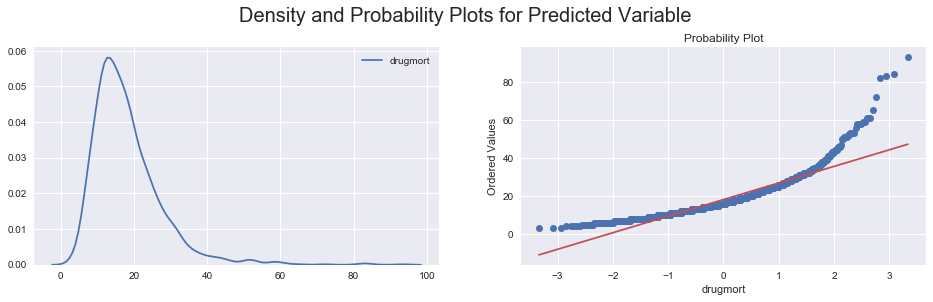

In [14]:
import scipy
from scipy import stats

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,4))
fig.suptitle('Density and Probability Plots for Predicted Variable',size = 20, y=1.02)

#Generate kernal density plot
_ = sns.kdeplot(df['drugmort'], ax = ax1)


#Generate probability plot
_ = stats.probplot(df['drugmort'], plot=plt)
_ = plt.xlabel("drugmort")


plt.show()

**Observation:** The distribution is skewed right with a long tail. The probability plot shows some curviture that suggests an exponential form. I will try a log function.

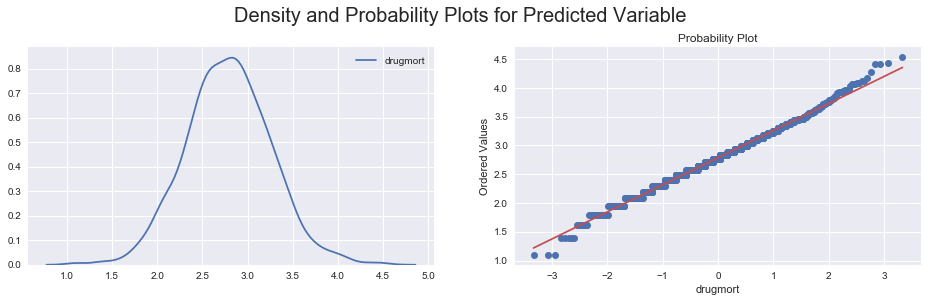

In [15]:
import scipy
from scipy import stats

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,4))
fig.suptitle('Density and Probability Plots for Predicted Variable',size = 20, y=1.02)

log = np.log(df['drugmort'])
#Generate kernal density plot
_ = sns.kdeplot(log, ax = ax1)

#Generate probability plot
_ = stats.probplot(log, plot=plt)
_ = plt.xlabel("drugmort")


plt.show()

**CONCLUSION:** Taking the log function of the predicted variable successfully adjusts the distribution (the log of a log-normal distribution is normal). I will use this value in the correlations. Next I will look at the shape of each feature variable and make transformations accordingly.


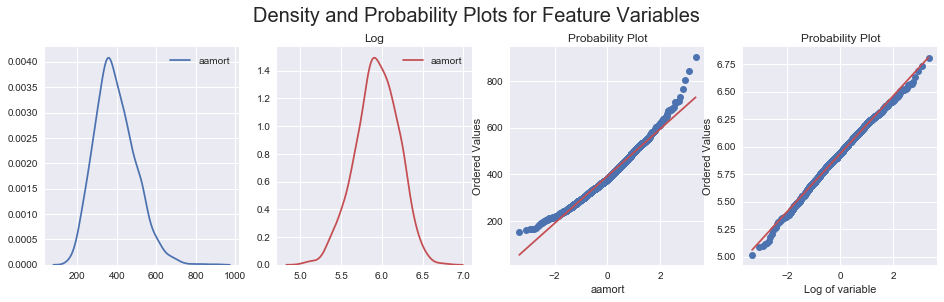

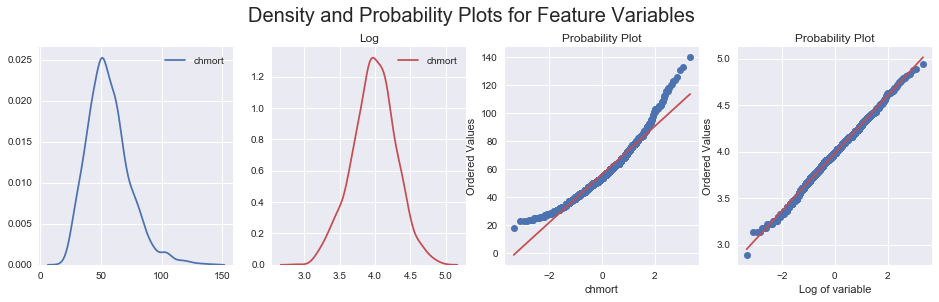

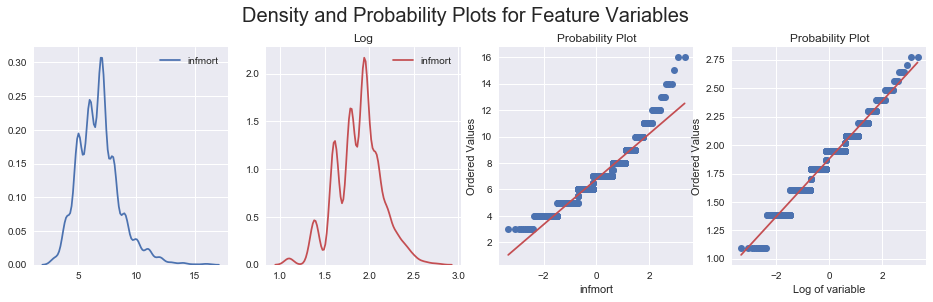

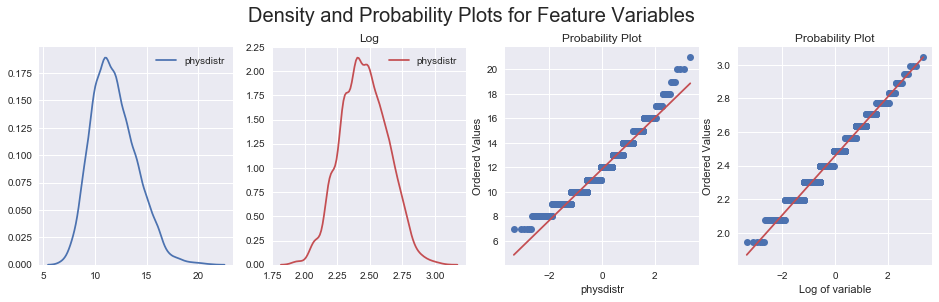

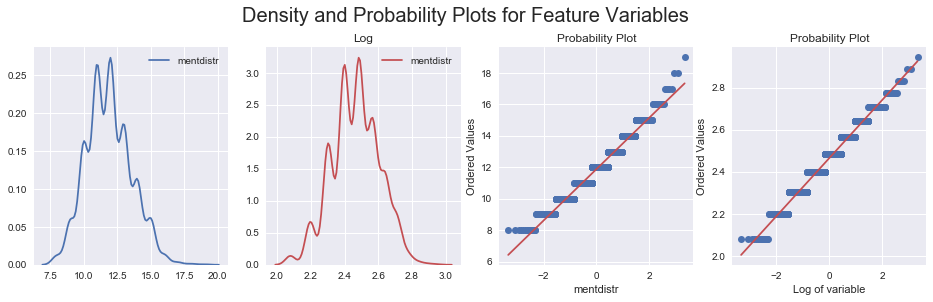

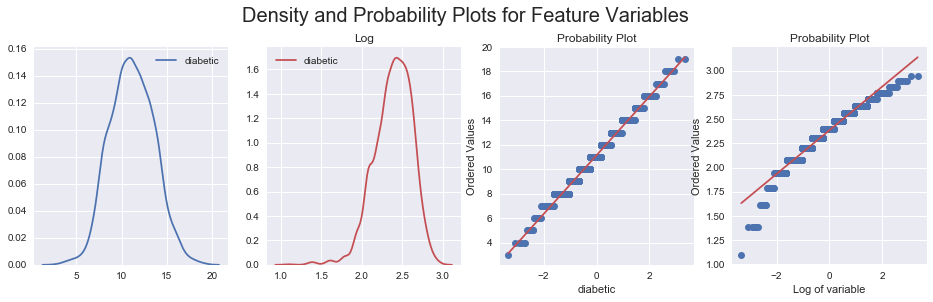

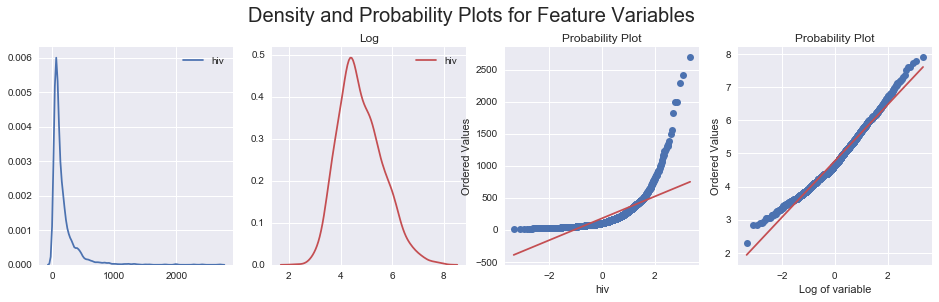

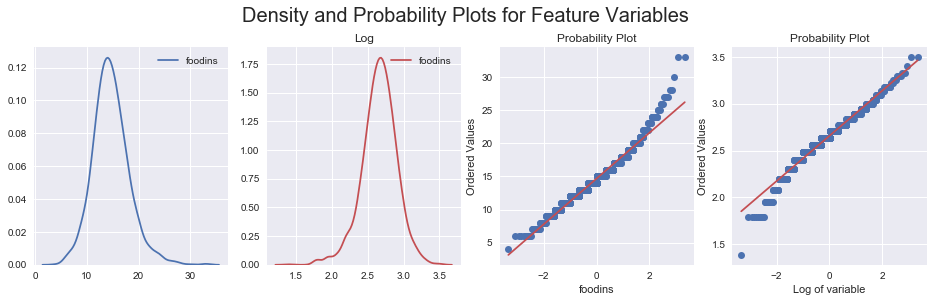

C:\Users\Valery\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning:

divide by zero encountered in log

C:\Users\Valery\Anaconda3\lib\site-packages\numpy\lib\function_base.py:3103: RuntimeWarning:

invalid value encountered in subtract

C:\Users\Valery\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning:

invalid value encountered in greater

C:\Users\Valery\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning:

invalid value encountered in less

C:\Users\Valery\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1821: RuntimeWarning:

invalid value encountered in less_equal



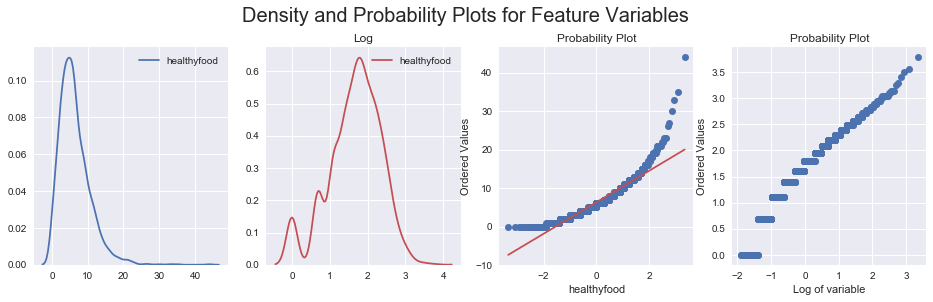

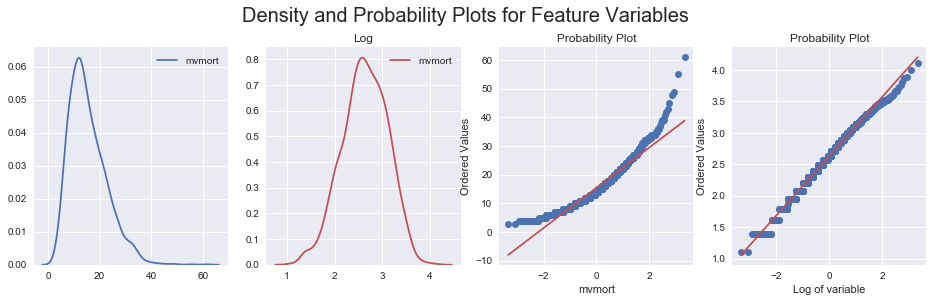

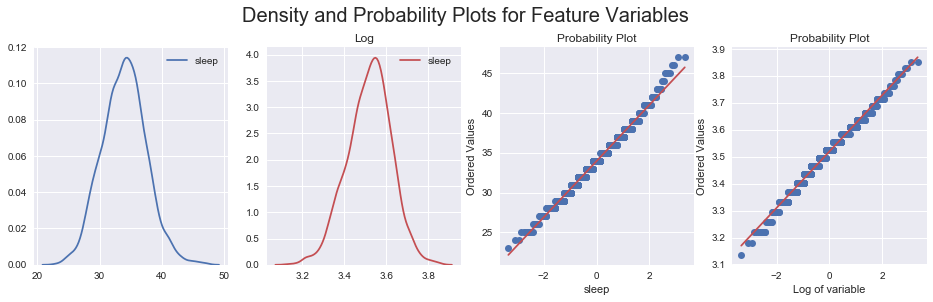

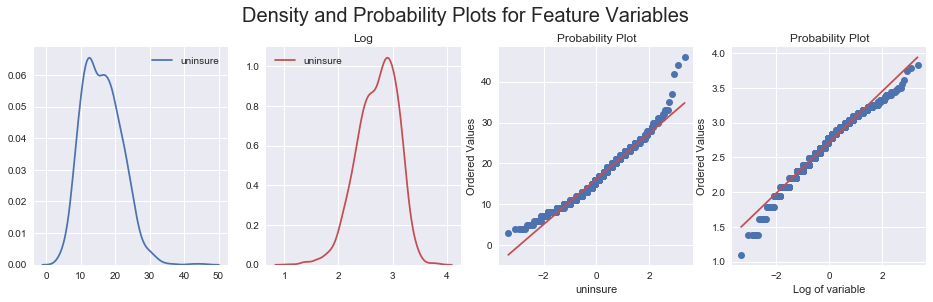

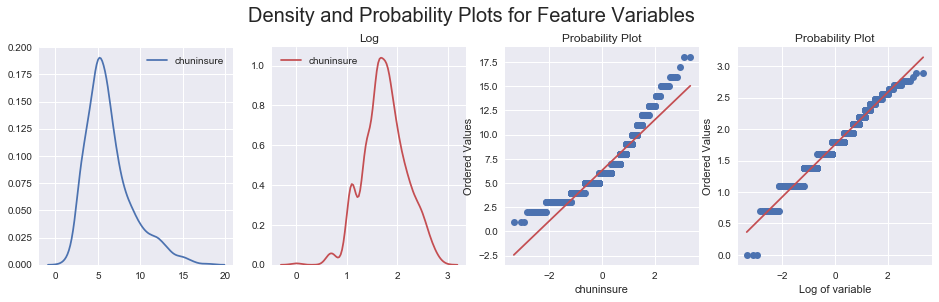

...

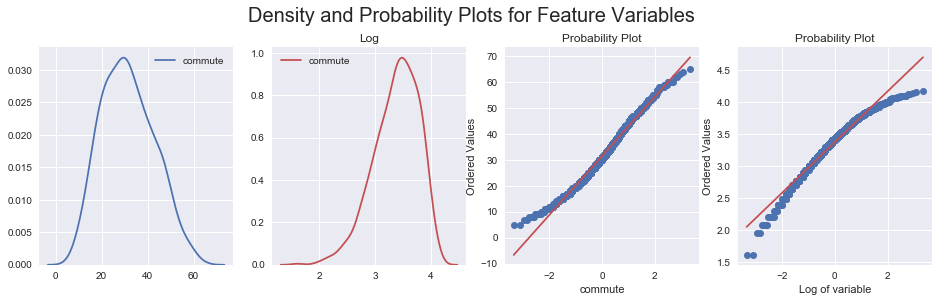

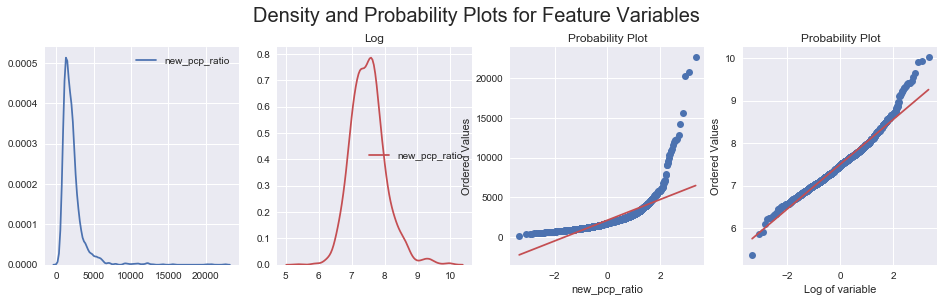

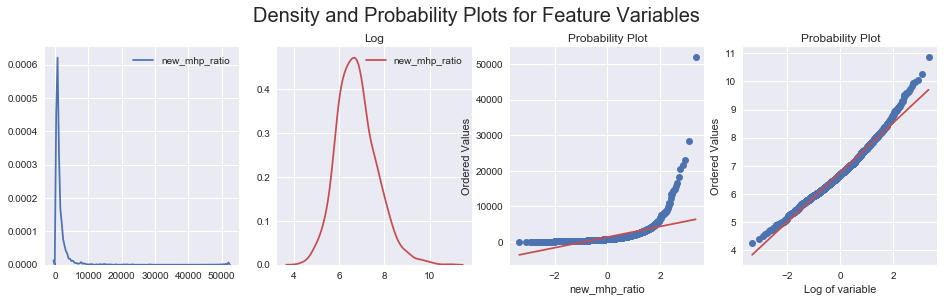

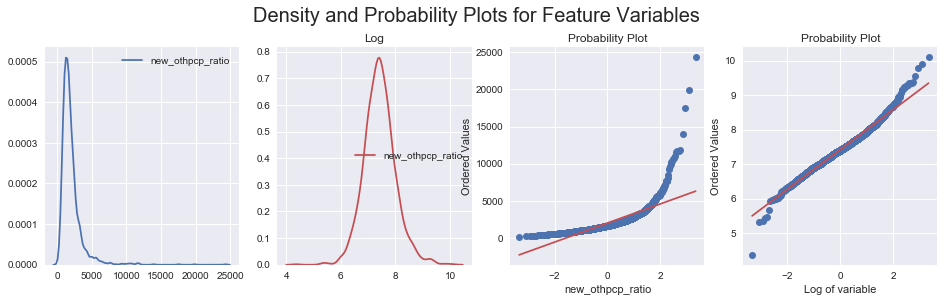

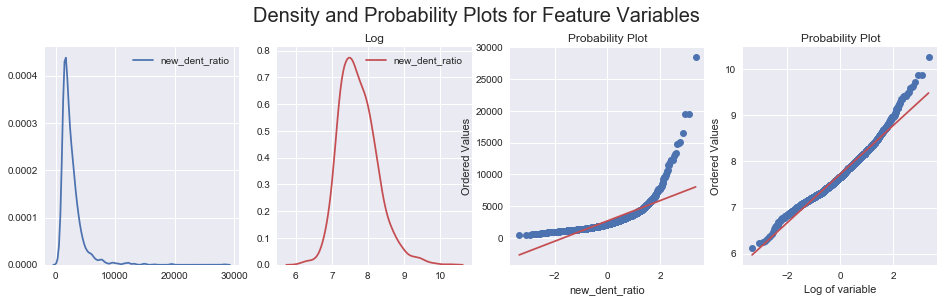

In [16]:
#Create a dataframe from the numerical columns.
df_plot = pd.DataFrame(data = df, columns = ['aamort', 'chmort', 'infmort', 'physdistr',
       'mentdistr', 'diabetic', 'hiv', 'foodins', 'healthyfood', 
       'mvmort', 'sleep', 'uninsure', 'chuninsure', 'healthcost', 'othpcp',
       'disconyouth', 'houseincome', 'freelunch', 'segbw', 'segnww',
       'homicide', 'firearm', 'under18', 'over65', 'aframer', 'amerindian',
       'asian', 'hawaiin', 'hispanic', 'nonhispanicw', 'nonenglish', 'female',
       'rural', 'lifelost', 'fairhealth', 'unhdays', 'mentunhdeays',
       'lowbirth', 'smokers', 'obese', 'foodindex', 'physinactive',
       'accessexercise', 'excdrinking', 'alcoholdrive', 'chlamydia',
       'teenbirth', 'uninsureunder65', 'prevhospital', 'hba1c', 'mammogram',
       'graduation', 'somecollege', 'laborforce', 'unemployed', 'chpoverty',
       'chpovertyb', 'chpovertyhis', 'chpovertyw', '80income', '20income',
       'singparent', 'socialassoc', 'violcrime', 'severehous', 'commute',
       'new_pcp_ratio', 'new_mhp_ratio', 'new_othpcp_ratio', 'new_dent_ratio'])

#Iterate over the numerical columns of the dataframe to create and display plots
for col in df_plot:
    data = str(col)
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(16,4))
    fig.suptitle('Density and Probability Plots for Feature Variables',size = 20, y=1.02)
    log = np.log(df[data])
    
    #Generate kernal density plot
    _ = sns.kdeplot(df[data], ax = ax1)
    _ = sns.kdeplot(log, ax = ax2, color="r").set_title('Log')
    _ = plt.xlabel(data)
    
    #Generate probability plot
    ax3 = plt.subplot(143)
    _ = stats.probplot(df_plot[data], plot=plt)
    _ = plt.xlabel(data)
     
    ax4 = plt.subplot(144)
    _ = stats.probplot(log, plot=plt)
    _ = plt.xlabel("Log of variable")
    plt.show()



### Initial Transformations

Here is a table for each variable with the necessary transformations recorded. TBD means that a transformation for that variable will be determined after an initial model fit, or will be scaled accordingly (these were not normal or log-normal).

|Variable Name |Transformation |
|--------------|--------------|
|drugmort|Log|
|aamort|Log|
|chmort|Log|
|infmort|Log|
|physdistr|Log|
|mentdistr|Log|
|diabetic|None|
|hiv|TBD|
|foodins|TBD|
|healthyfood|TBD|
|mvmort|Log|
|sleep|Log|
|uninsure|TBD|
|chuninsure|TBD|
|healthcost|Log|
|othpcp|TBD|
|disconyouth|TBD|
|houseincome|Log|
|freelunch|None|
|segbw|None|
|segnww|TBD|
|homicide|Log|
|firearm|Log|
|under18|TBD|
|over65|Log|
|aframer|TBD|
|amerindian|TBD|
|asian|TBD|
|hawaiin|TBD|
|hispanic|TBD|
|nonhispanicw|TBD|
|nonenglish|TBD|
|female|TBD|
|rural|TBD|
|lifelost|Log|
|fairhealth|Log|
|unhdays|Log|
|mentunhdeays|None|
|lowbirth|Log|
|smokers|None|
|obese|None|
|foodindex|TBD|
|physinactive|None|
|accessexercise|TBD|
|excdrinking|TBD|
|alcoholdrive|None|
|chlamydia|Log|
|teenbirth|TBD|
|uninsureunder65|TBD|
|prevhospital|Log|
|hba1c|TBD|
|mammogram|None|
|graduation|TBD|
|somecollege|None|
|laborforce|TBD|
|unemployed|Outliers|
|chpoverty|TBD|
|chpovertyb|None|
|chpovertyhis|TBD|
|chpovertyw|TBD|
|80income|TBD|
|20income|Log|
|singparent|Log|
|socialassoc|TBD|
|violcrime|Log|
|severehous|Log|
|commute|TBD|
|new_pcp_ratio|TBD|
|new_mhp_ratio|Log|
|new_othpcp_ratio|Log|
|new_dent_ratio|Log|



Now that I have determined which variables should be log-variables, I construct a dataframe for just the log of the predicted variable: df_drugmort. Then I construct a dataframe of the log of the feature variables: df_log. Then I perform an inner-join to merge them into one dataframe: df_logvar. Finally, I create probability plots to check that the transformed variables are normal.


(1623, 1)
(1623, 25)


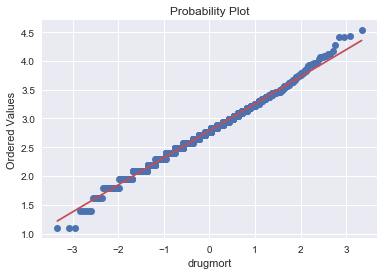

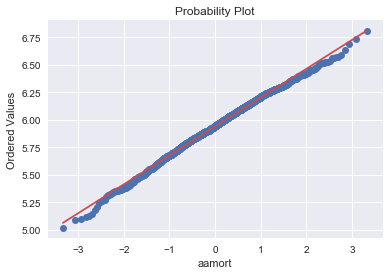

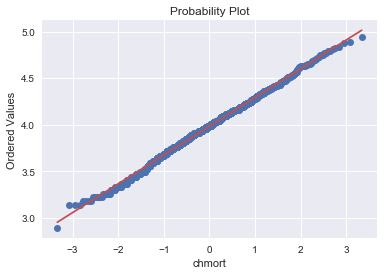

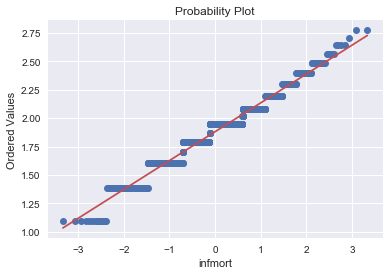

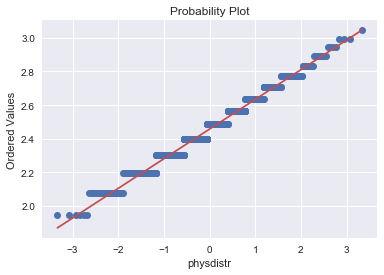

...

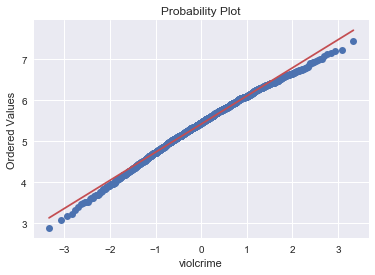

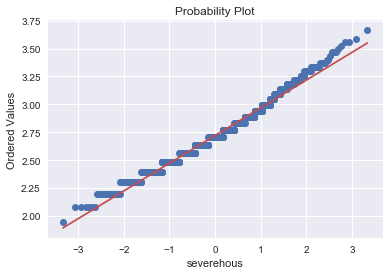

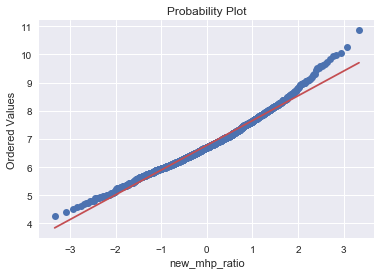

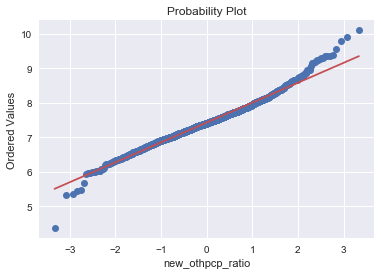

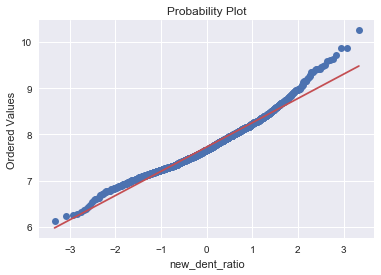

In [17]:
#Create dataframe for log of predicted variable
drugmort = np.log(df['drugmort'])
df_drugmort = pd.DataFrame(data=drugmort)

#Take the log for all the log-normal variables.
df_log = pd.DataFrame(data = df_plot, columns = ['aamort', 'chmort', 'infmort', 'physdistr', 'mentdistr', 
                 'mvmort', 'sleep', 'healthcost', 'houseincome', 'homicide', 'firearm', 
                 'over65', 'lifelost', 'fairhealth', 'unhdays', 'lowbirth', 'chlamydia', 
                 'prevhospital', '20income', 'singparent', 'violcrime', 'severehous', 
                 'new_mhp_ratio', 'new_othpcp_ratio', 'new_dent_ratio'])

df_log = np.log(df_log)

#Check the shape of the dataframes before joining
print(df_drugmort.shape)
print(df_log.shape)

#Inner join dataframe of log variables with log of predicted variable
left = df_drugmort
right = df_log

df_logvar = pd.merge(left, right, left_index=True, right_index=True)



#Iterate over the log columns of the dataframe to create and display probability plots
for col in df_logvar:
    data = str(col)
    fig.suptitle('Probability Plots for log Feature Variables',size = 20, y=1.02)
    
    #Generate probability plot
    _ = stats.probplot(df_logvar[data], plot=plt)
    _ = plt.xlabel(data)
    plt.show()



These look good. The next step is to join the log variables with the remaining variables. I perform an inner-join and the resulting dataframe is ready for analysis. I perform a pearson-r correlation for all the feature variables with the predicted variable: drugmort.

In [18]:
#Create dataframe of numerical variables that are not log-normal
df_var = pd.DataFrame(data = df_plot, columns =['diabetic', 'hiv', 'foodins', 'healthyfood', 'uninsure', 'chuninsure', 'othpcp', 'disconyouth', 
  'freelunch', 'segbw', 'segnww', 'under18', 'aframer', 'amerindian', 'asian', 'hawaiin', 'hispanic', 
  'nonhispanicw', 'nonenglish', 'female', 'rural', 'mentunhdeays', 'smokers', 'obese', 'foodindex', 
  'physinactive', 'accessexercise', 'excdrinking', 'alcoholdrive', 'teenbirth', 'uninsureunder65', 'hba1c', 
  'mammogram', 'graduation', 'somecollege', 'laborforce', 'unemployed', 'chpoverty', 'chpovertyb', 
  'chpovertyhis', 'chpovertyw', '80income', 'socialassoc', 'commute', 'new_pcp_ratio'])

#Perform inner join with log-variables
left = df_logvar
right = df_var

df_firsttransf = pd.merge(left, right, left_index=True, right_index=True)

df_firsttransf.shape
df_firsttransf.head()

,drugmort,aamort,chmort,infmort,physdistr,mentdistr,mvmort,sleep,healthcost,houseincome,...,laborforce,unemployed,chpoverty,chpovertyb,chpovertyhis,chpovertyw,80income,socialassoc,commute,new_pcp_ratio
0,2.302585,6.148468,4.007333,1.945910,2.484907,2.564949,2.944439,3.637586,9.196140,10.943411,...,25308.0,5.2,19.0,43.0,48.0,11.0,97896.0,13.7,43,2408.0
1,2.833213,5.888878,3.871201,1.791759,2.484907,2.484907,2.708050,3.496508,9.149847,10.866414,...,87316.0,5.5,20.0,50.0,12.0,14.0,99839.0,11.5,38,1352.0
2,2.708050,6.255750,4.653960,2.484907,2.564949,2.564949,3.091042,3.713572,9.288874,10.615628,...,8490.0,6.6,29.0,61.0,48.0,18.0,78138.0,10.2,47,2501.0
3,3.044522,6.098074,3.784190,1.791759,2.564949,2.564949,3.044522,3.583519,9.213934,10.829471,...,24352.0,5.4,22.0,20.0,57.0,21.0,83484.0,8.5,60,5247.0
4,2.564949,6.309918,4.248495,2.079442,2.639057,2.639057,2.708050,3.663562,9.275472,10.647589,...,46051.0,7.0,31.0,59.0,40.0,21.0,79864.0,14.7,30,1505.0


#### Top Pearson r correlations

In [23]:
corrlist = []
i=0

#Iterate over the numerical columns of df_firsttransf to compare correlations
for col in df_firsttransf:
    data = str(col)
   
    #Get pearson correlations for each
    corr = scipy.stats.pearsonr(df[data], df['drugmort'])
 
    #Print variables with the highest correlations with drugmort
    
    if (abs(corr[0]) > .3):
        i+=1
        corrlist.append(col)
        print(i, '. ', col, corr)
print('\n', corrlist)



1 .  drugmort (1.0, 0.0)
2 .  aamort (0.5067164717778029, 1.3829637894080028e-106)
3 .  physdistr (0.36596517623109764, 1.313177994015847e-52)
4 .  mentdistr (0.3711404857493212, 3.617679031579577e-54)
5 .  mvmort (0.32891093505205865, 2.995386847957984e-42)
6 .  houseincome (-0.3037376167087228, 5.508136029050244e-36)
7 .  firearm (0.3429341267227492, 5.24990124383702e-46)
8 .  lifelost (0.5277770167144498, 4.4739342585107524e-117)
9 .  unhdays (0.399651857136568, 2.747285267302639e-63)
10 .  prevhospital (0.42918869044347485, 1.0011075658190657e-73)
11 .  diabetic (0.32495785614706085, 3.1650049705083616e-41)
12 .  disconyouth (0.36620343675418493, 1.1146437771827911e-52)
13 .  mentunhdeays (0.4029567316912545, 2.101096724318074e-64)
14 .  smokers (0.3915860355978991, 1.2912924326857186e-60)
15 .  physinactive (0.3168919931867131, 3.48936842837689e-39)
16 .  excdrinking (-0.3687879266681688, 1.8666463241354584e-53)
17 .  somecollege (-0.33812911122574896, 1.0696407572853577e-44)
18 .

**CONCLUSION:**  There are 20 variables that are correlated with the predicted variable. The highest correlations are 'lifelost' which is a measure of all premature death, and age-adjusted mortality (aamort). These are likely to be collinear with 'drugmort' so they will be looked at closely during PCA and preprocessing. The next highest correlations are mentally unhealthy days (mentunhdeays), the percent of white children who are in poverty (chpovertyw), the number of preventable hospital stays, and the percent of adult smokers and number of unhealthy days in the last 30 days. The remaining are variables representing different measures of health conditions (diabetic), mental and physical distress, physical inactivity, and disconnected youth. Of note is that household income is negatively correlated with drug overdose mortality, as is having some college and exessive drinking. Also of note is that firearm fatalities is positively correlated.

Just this analysis paints a fairly clear picture of a community at risk of drug overdose deaths. Most of these are measures of or are related to increased environmental or social stressors. The next steps is to subject these 20 feature variables to PCA to further reduce the data before modeling.

The following are scatter plots of all of variables.



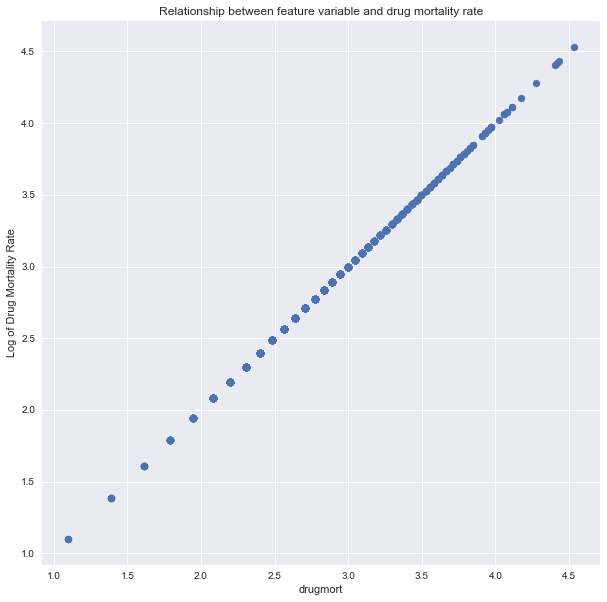

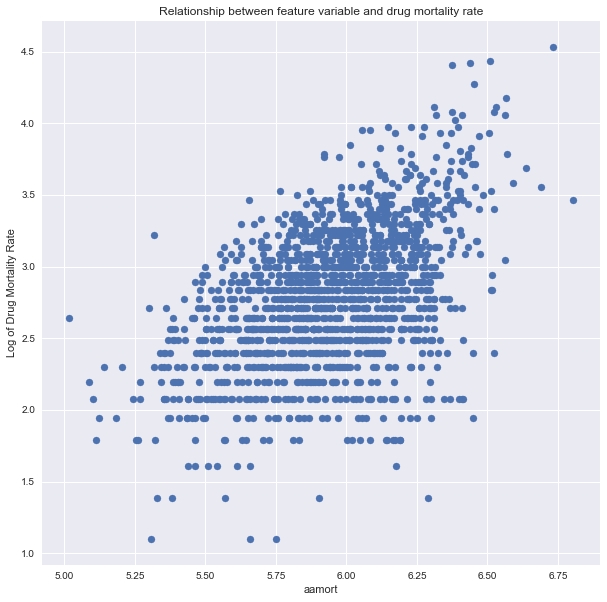

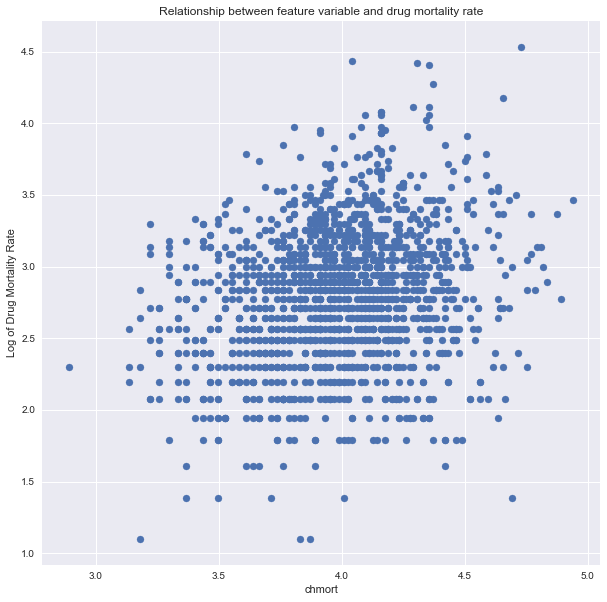

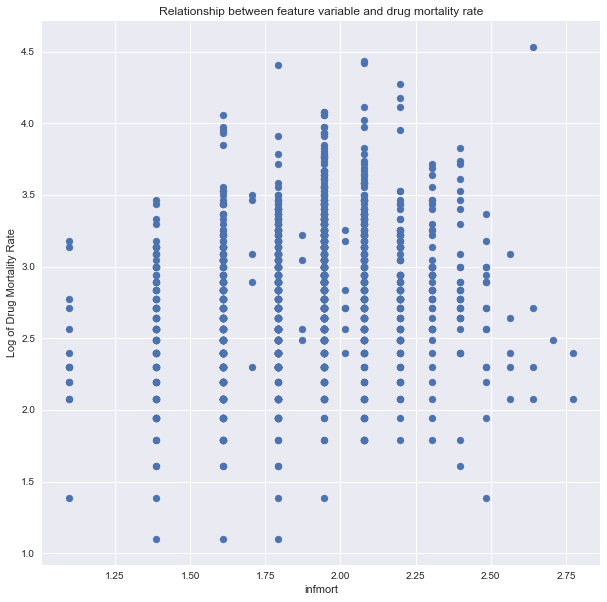

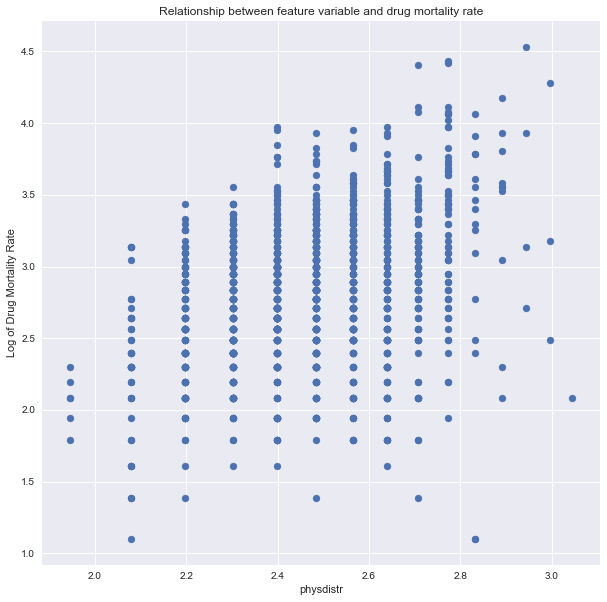

...

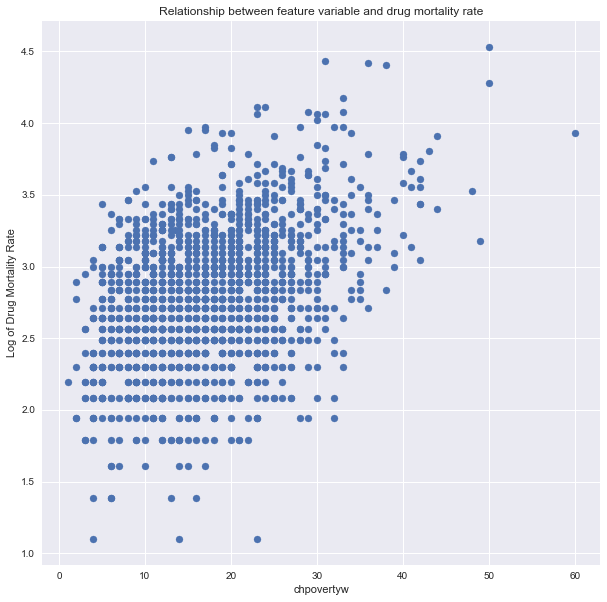

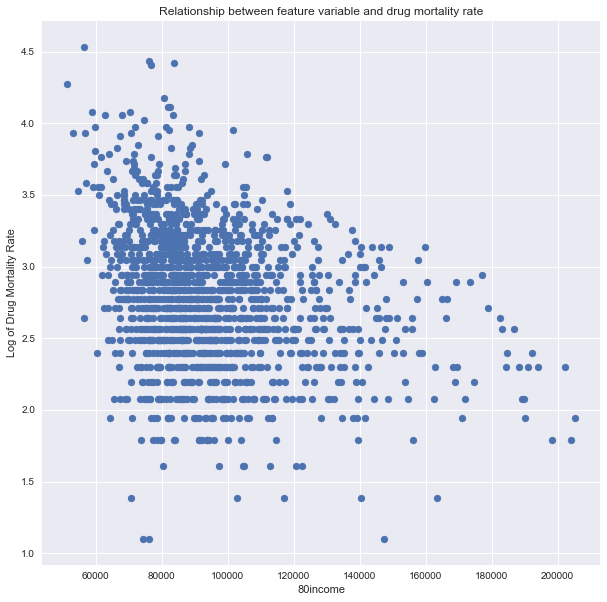

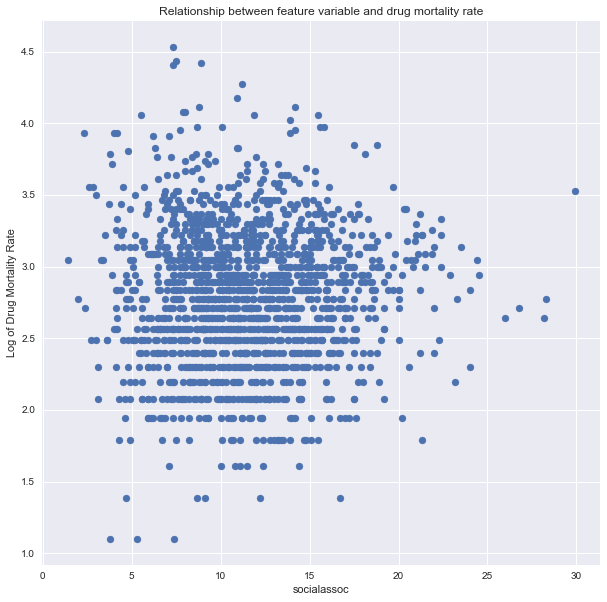

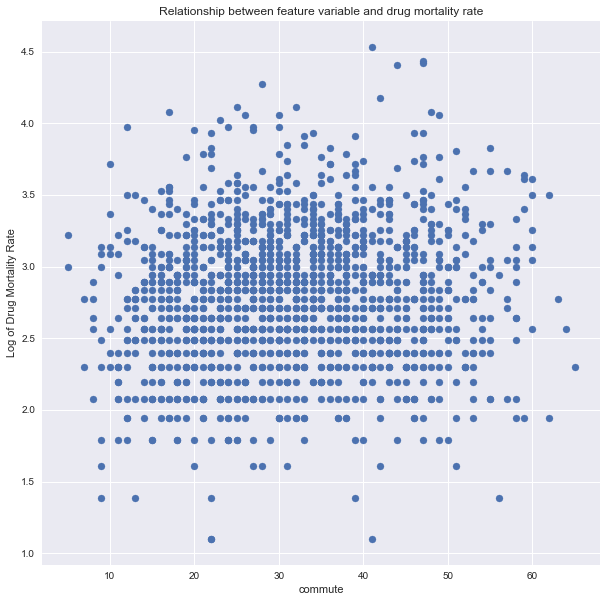

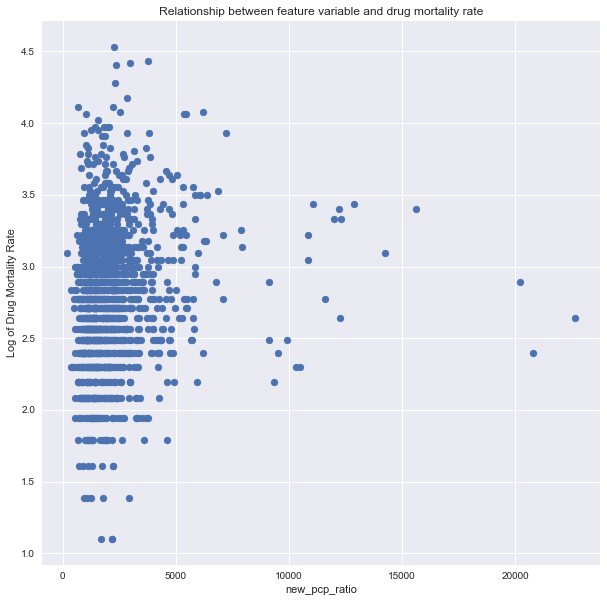

In [20]:
import matplotlib.pyplot as plt


#Iterate over the log columns of the dataframe to create and display probability plots
for col in df_firsttransf:
    data = str(col)
    
    #Generate scatterplots
    plt.figure(figsize=(10,10))
    _ = plt.scatter(x=df_firsttransf[data], y=df_firsttransf['drugmort'])
    _ = plt.xlabel(data)
    _ = plt.ylabel('Log of Drug Mortality Rate')
    _ = plt.title('Relationship between feature variable and drug mortality rate')
    plt.show()

    
    
    
    
    

Below I create a correlation matrix to visualize the correlations between the response and predictor variables. Any collinearity between variables will also be shown.

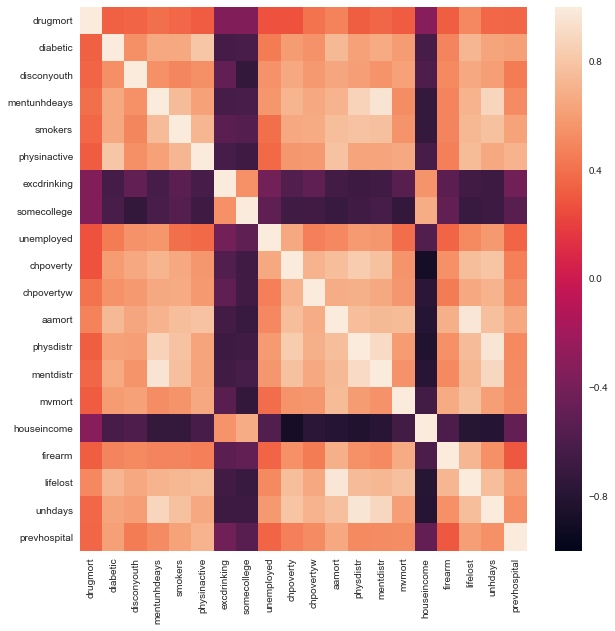

<Figure size 432x288 with 0 Axes>

In [30]:
df_cor = pd.DataFrame(data = df_firsttransf, columns = ['drugmort', 'diabetic', 'disconyouth', 'mentunhdeays', 'smokers', 'physinactive', 'excdrinking', 'somecollege', 
                       'unemployed', 'chpoverty', 'chpovertyw', 'aamort', 'physdistr', 'mentdistr', 'mvmort', 
                       'houseincome', 'firearm', 'lifelost', 'unhdays', 'prevhospital'])

corr_matrix = df_cor.corr()
#print(corr_matrix)

# Visualize the covariance matrix using a heatmap
plt.figure(figsize=(10,10))
sns.heatmap(corr_matrix, vmin=-1, vmax=1)


# Display the heatmap
plt.show()

#Save the figure to a file for reporting
plt.savefig('heatmap.png')

Below I create a final dataframe of the top 20 untransformed correlated variables that will be sent for PCA and preprocessing. I write it to a csv and save.

In [26]:
df_pca = pd.DataFrame(data = df, columns = ['drugmort', 'diabetic', 'disconyouth', 'mentunhdeays', 'smokers', 'physinactive', 'excdrinking', 'somecollege', 
                       'unemployed', 'chpoverty', 'chpovertyw', 'aamort', 'physdistr', 'mentdistr', 'mvmort', 
                       'houseincome', 'firearm', 'lifelost', 'unhdays', 'prevhospital'])

#Send dataframe to csv
df_pca.to_csv('VLynn_DrugOverdose_EDA.csv')

### CONCLUSION: 

Many of the variables were initially normal or log-normal. Taking the log of the log-normal variables made them normal. I performed the Pearson-r correlation test and listed any that were over the absolute value of 0.3. This left me with 20 well-correlated variables that I saved as a csv file for PCA and preprocessing. 

The correlated variables were measures of economic and social status, environmental stressors, and physical and mental health. This indicates that counties where there is more poverty (or lack of wealth), lower access to physical and mental health services, and higher rates of environmental stress are more at-risk for drug overdose deaths. 